# SIFT Experiments

The idea comes after reviewing some photos of New Year Eve 2020.

We tried to merge shots with fireworks to make the final output more beautiful.

So Adobe Lightroom was not the best option.

Let's use Python! =)

## Preparation

One time installation of requires packages. Such specific versions is needed bacause of SIFT algorithm (which we will use) is patented feature.

In [1]:
!pip3 install opencv-python==3.4.2.17 opencv-contrib-python==3.4.2.17

## Imports

* `os` - for the access to filesystem
* `cv2` - for open-cv
* ...

In [2]:
import os
import copy

import cv2
import matplotlib.pyplot as plt
import numpy as np

In [3]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

# Start of our experiments

## Basic operations under images

Read image from local filesystem and show with `matplotlib` help:

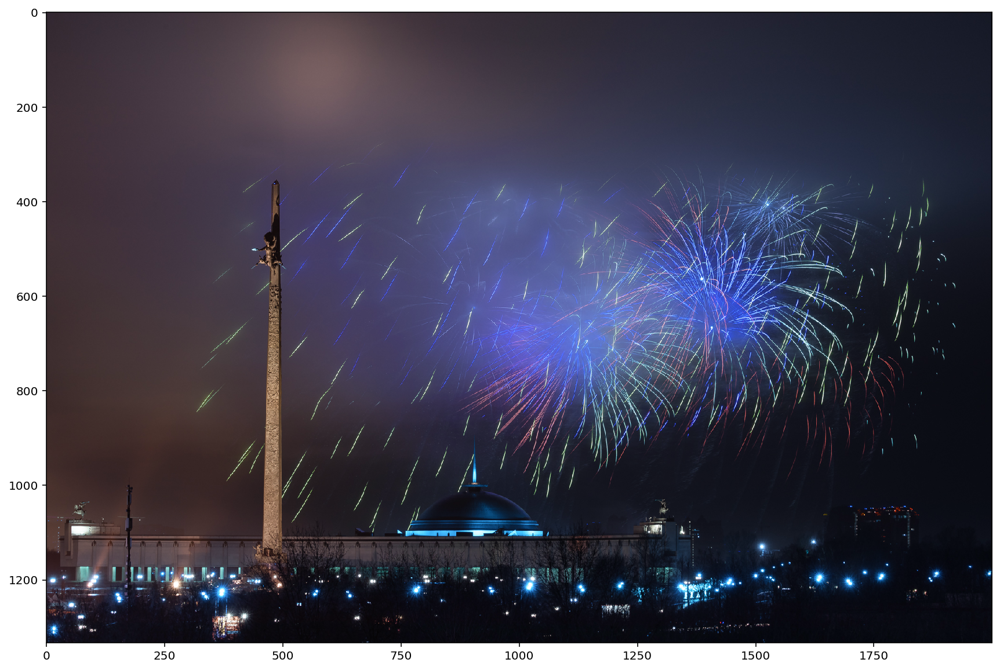

In [4]:
image_1 = cv2.imread('./res/BB3A6939.jpg')
plt.figure(figsize=(15, 10))
plt.imshow(image_1)
plt.show()

As an old open-cv feature image was opened in BGR color scheme.

Let's convert it to classic view (RGB):

In [5]:
# convert color scheme
rgb_image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2RGB)

Now we show image in classic RGB color scheme using `interpolation='bilinear'` to avoid pixels' columns loosing.

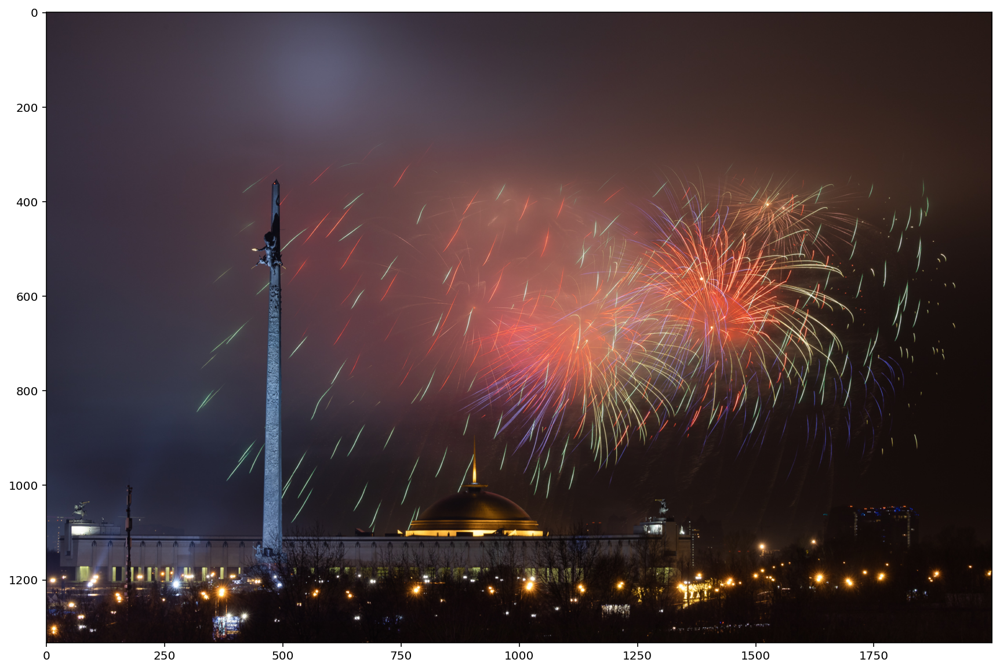

In [6]:
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_1, interpolation='bilinear')
plt.show()

Repeat all the same of the second image (as CtrlC+CtrlV).

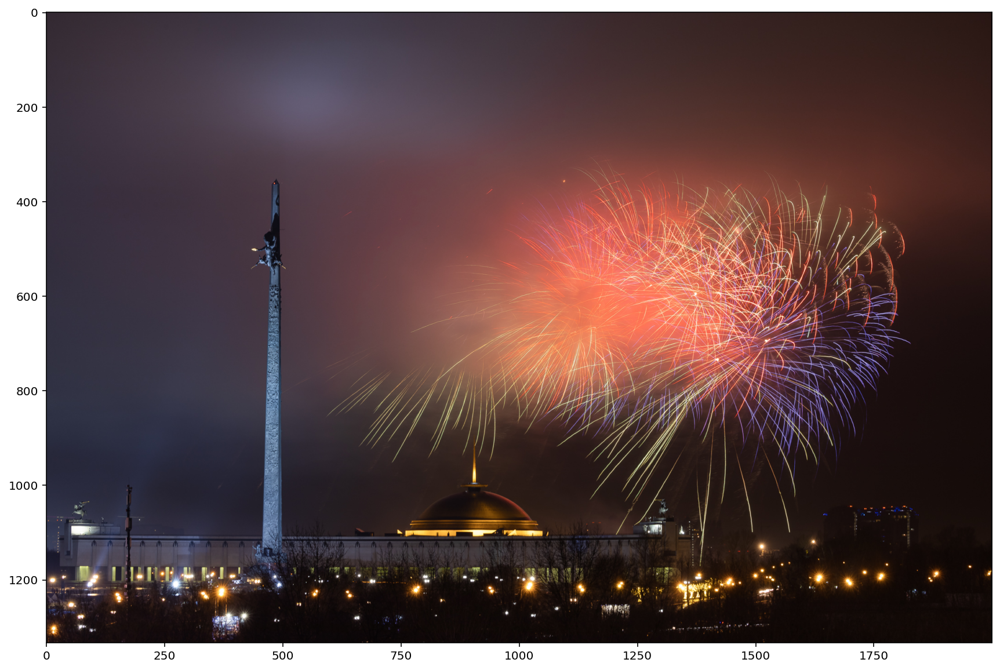

In [7]:
image_2 = cv2.imread('./res/BB3A6940.jpg')
rgb_image_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_2, interpolation='bilinear')
plt.show()

Next we try to unite 2 images by adding light value from each pixel of the second image to the first.

To do such operation we can not use simple adding `rgb_image_1 + rgb_image_2`, because each value has got `uint8` type and max value `255`. 
First we divide all values by `2` and next uniting. We avoid the overflow of each value if it is greater than 255.

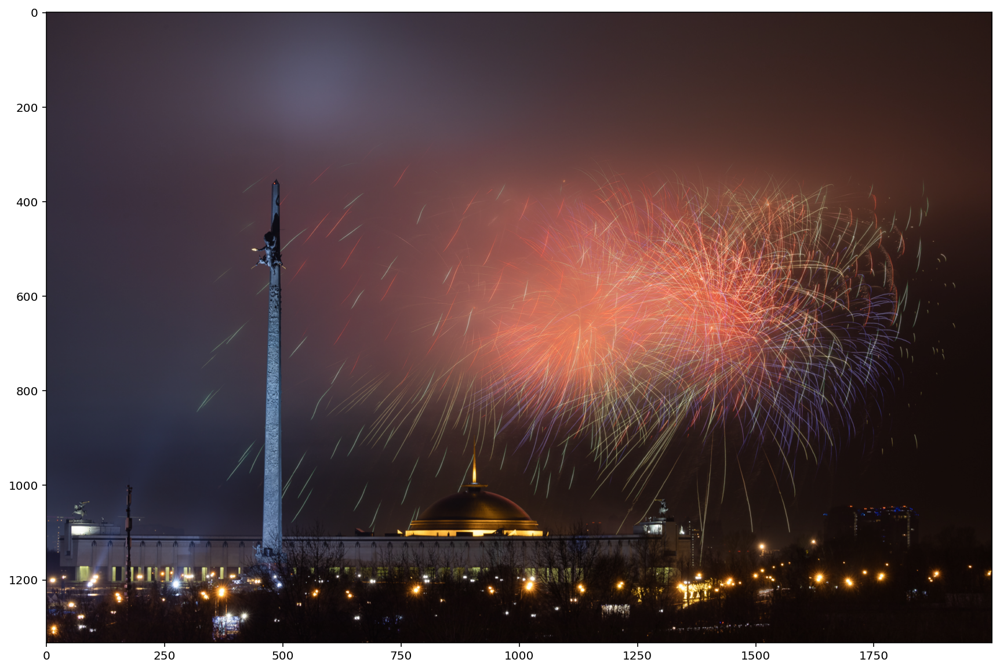

In [8]:
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_1//2 + rgb_image_2//2, interpolation='bilinear')

On the output imgae above you can see that blue tracks are less lighter than on original (second) image. It happens because of first image mostly hasn't got same tracks on the same positions, so their final light becomes 2 times less.

To solve this issue we are choose another operation to unite photos (non-adding union).
Now each pixel `(x, y)` (x, y - coordinates) of the output image has got the greatest value from two images' pixels on the positions.

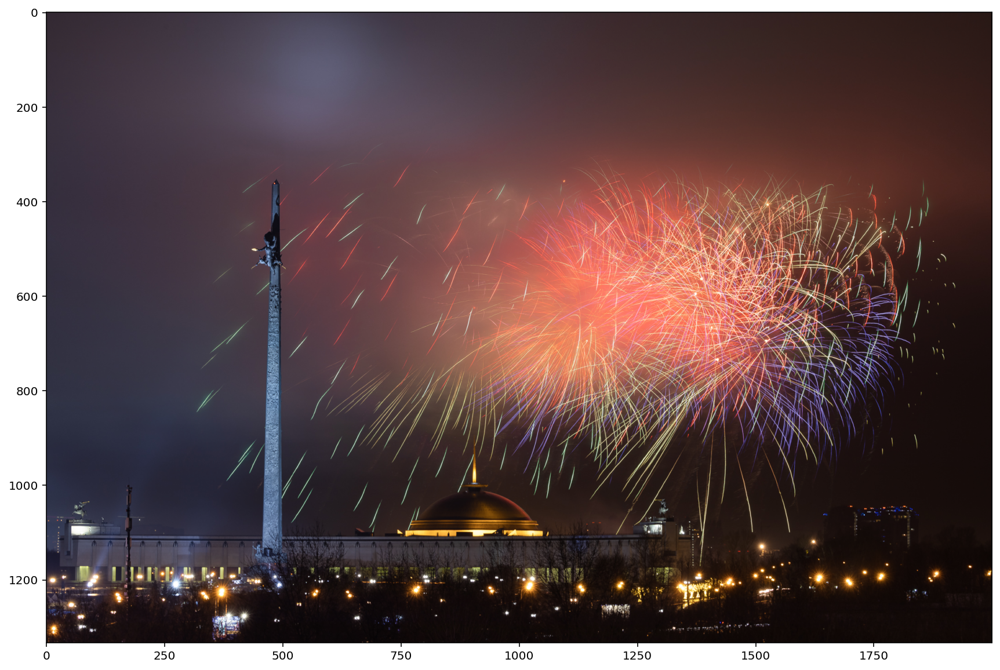

In [9]:
plt.figure(figsize=(15, 10))
plt.imshow(np.maximum(rgb_image_1, rgb_image_2), interpolation='bilinear')

Now we want to play with more than 2 photos, with a set of them.
Here a set of operations performs:
  * Read each image from given path and form the value e.g. `'./res/BB3A6938.jpg'` (forming relative path to each of them)
  * Read each using open-cv
  * Convert to RGB

In [10]:
img_arr = ['./res/'+x for x in os.listdir('./res/')]
read_im_arr = [cv2.imread(x) for x in img_arr]
rgb_img_arr = [cv2.cvtColor(x, cv2.COLOR_BGR2RGB) for x in read_im_arr]

Unite all of read photos to output image using `np.amax` (the same to `np.maximum` but for array of arrays).

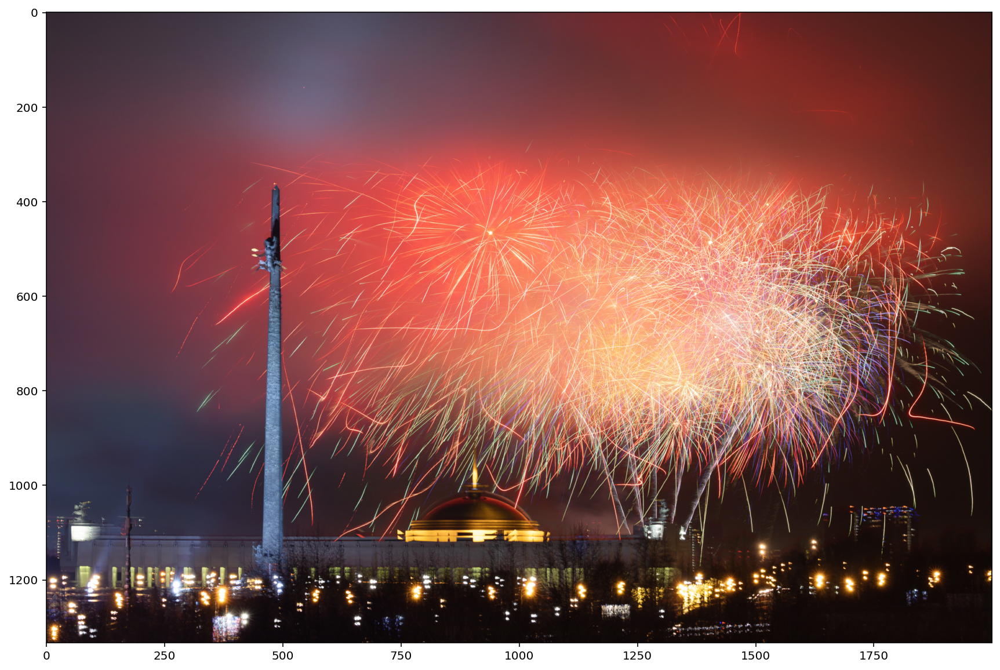

In [11]:
plt.figure(figsize=(15, 10))
# np.array(rgb_img_arr).shape
plt.imshow(np.amax(np.array(rgb_img_arr), axis=0), interpolation='bilinear')

## Advanced operatins

On the image above you see another annoying issue. 

**Shaking.**

It happened because of camre wasn't locked carefully on the tripod, so wind shacked it a bit (built-in stab in camera helped with each photo but not for the whole set of them).

Now we begin to solve it.

_Based on https://www.pyimagesearch.com/2018/12/17/image-stitching-with-opencv-and-python/_

In [12]:
img_arr_np = np.array(rgb_img_arr)

In [13]:
img_arr_np.shape

(8, 1333, 2000, 3)

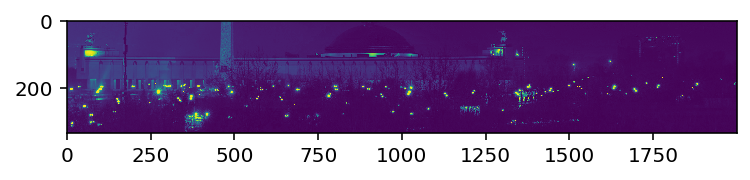

In [14]:
plt.imshow(np.amin(img_arr_np[7, 1000:, :, :], axis=2))

In [15]:
img_arr_np[7, 1000:, :, :].shape

(333, 2000, 3)

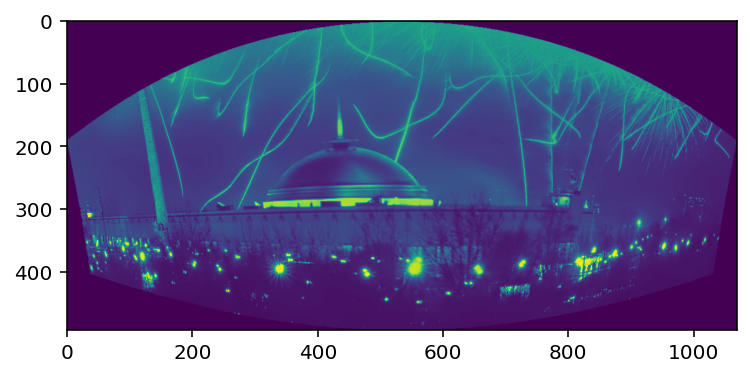

In [16]:
# initialize OpenCV's image stitcher object and then perform the image
# stitching
stitcher = cv2.createStitcher()
(status, stitched) = stitcher.stitch(img_arr_np[:, 800:, :, :])
plt.imshow(np.amax(np.array(stitched), axis=2), interpolation='bilinear')

The way of using lib's functions `cv2.createStitcher()` and `stitcher.stitch(...)` was without any success.
We defined that problem comes from huge amout of high saturated data on photos (colored tracks).

So let's try SIFT approach.

_Based on https://www.pyimagesearch.com/2016/01/11/opencv-panorama-stitching/_

Functions below are taken from the link above.

In [17]:
def detectAndDescribe(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # detect and extract features from the image
    descriptor = cv2.xfeatures2d.SIFT_create()
    (kps, features) = descriptor.detectAndCompute(image, None)

    # convert the keypoints from KeyPoint objects to NumPy
    # arrays
    kps = np.float32([kp.pt for kp in kps])

    # return a tuple of keypoints and features
    return (kps, features)

In [18]:
def matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh):
    # compute the raw matches and initialize the list of actual
    # matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    rawMatches = matcher.knnMatch(featuresA, featuresB, 2)
    matches = []

    # loop over the raw matches
    for m in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append((m[0].trainIdx, m[0].queryIdx))
    
    # computing a homography requires at least 4 matches
    if len(matches) > 4:
        # construct the two sets of points
        ptsA = np.float32([kpsA[i] for (_, i) in matches])
        ptsB = np.float32([kpsB[i] for (i, _) in matches])

        # compute the homography between the two sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC, reprojThresh)

        # return the matches along with the homograpy matrix
        # and status of each matched point
        return (matches, H, status)
    # otherwise, no homograpy could be computed
    return None

In [19]:
def drawMatches(imageA, imageB, kpsA, kpsB, matches, status):
    # initialize the output visualization image
    (hA, wA) = imageA.shape[:2]
    (hB, wB) = imageB.shape[:2]
    vis = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    vis[0:hA, 0:wA] = imageA
    vis[0:hB, wA:] = imageB

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
        # only process the match if the keypoint was successfully
        # matched
        if s == 1:
            # draw the match
            ptA = (int(kpsA[queryIdx][0]), int(kpsA[queryIdx][1]))
            ptB = (int(kpsB[trainIdx][0]) + wA, int(kpsB[trainIdx][1]))
            cv2.line(vis, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return vis

In [20]:
def getMatches(imgA, imgB, drawmatches=False):
    img_arr_np = np.array(rgb_img_arr)
    (kpsA, featuresA) = detectAndDescribe(imgA)
    (kpsB, featuresB) = detectAndDescribe(imgB)

    ratio = 0.75
    reprojThresh = 4
    # match features between the two images
    M = matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh)

    (matches, H, status) = M
    
    if drawmatches:
        plt.figure(figsize=(15, 10))
        plt.imshow(drawMatches(imgA, imgB, kpsA, kpsB, matches, status), interpolation='bilinear')
        plt.show()
        
    return M

In [21]:
def plot_imgs(imgs):
    fig, ax = plt.subplots(1, len(imgs), figsize=(15, 10))
    for i in range(len(imgs)):
        ax[i].imshow(imgs[i])
    plt.show()

In [22]:
def stitch(imgA, imgB):
    matches, H, status = getMatches(imgA, imgB, 1)
    
    result = cv2.warpPerspective(imgA, H, (imgA.shape[1] + imgB.shape[1], imgA.shape[0]))
    #result[0:img_arr_np[1].shape[0], 0:img_arr_np[1].shape[1]] = img_arr_np[1]
   
    i1 = copy.deepcopy(result)
    plot_imgs([i1, imgB])
    i2 = result
    i2[0:imgB.shape[0], 0:imgB.shape[1]] = imgB
    
    plot_imgs([i1, i2])
    r = np.amax(np.array([i1, i2]), axis=0)
    return r

* `def detectAndDescribe(image)` - main SIFT computations
* `def matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh) - method to find pair `(kps, features)` (keypoints, features)` for one image
* `def drawMatches(imageA, imageB, kpsA, kpsB, matches, status)` - draw match lines between to images
* `def getMatches(imgA, imgB, drawmatches=False)` - define matches for 2 images using `matchKeypoints(...)` and draw result if needed using `drawMatches(...)`
* `def plot_imgs(imgs)` - plot images from array
* `def stitch(imgA, imgB)` - stich 2 images by uniting with `np.amax(...)`

The core idea we transform `imgA` to be equal pixel-by-pixel to `imgB` (both pixels contain "equal" data).
To process more than 2 images you need to create output result from 2 initial photos to `res` variable and next to call `stitch(res, <next image)`.

Feel free to play with next pathes:

* `path = './laptops/'`
* `path = './pp/'`
* `path = './res/'`

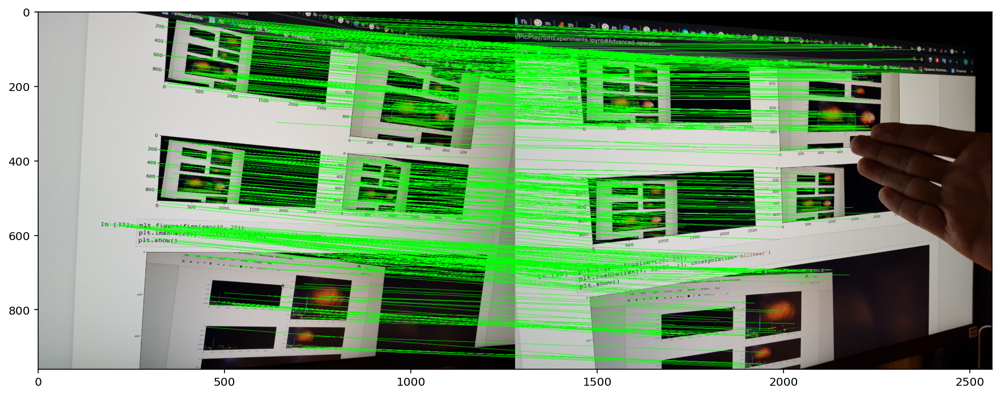

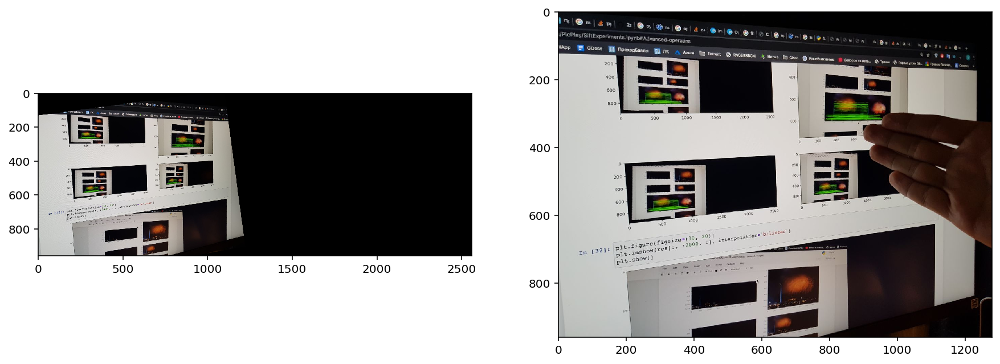

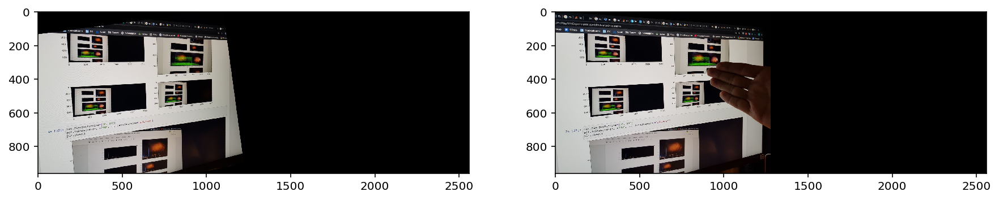

In [33]:
path = './laptops/'
rgb_img_arr = list(reversed([cv2.cvtColor(cv2.imread(path + x), cv2.COLOR_BGR2RGB) for x in os.listdir(path)]))

imgA = rgb_img_arr[0]
imgB = rgb_img_arr[1]

res = stitch(imgA, imgB)
for x in range(len(rgb_img_arr)-2):
    res = stitch(res[:, :2000, :], rgb_img_arr[x+2])

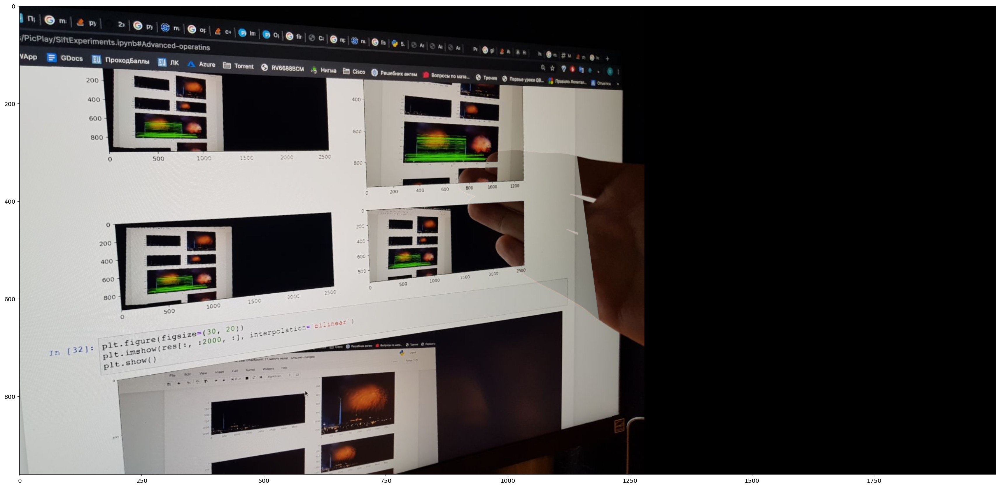

In [34]:
plt.figure(figsize=(30, 20))
plt.imshow(res[:, :2000, :], interpolation='bilinear')
plt.show()

In [ ]:
plot_imgs(img_arr_np)